# Introduction to dataprep

## Load libraries

In [95]:
from dataprep.eda import plot
from dataprep.eda import plot_correlation
from dataprep.eda import plot_missing
from dataprep.eda import create_report

import datetime as dt

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style="whitegrid", color_codes=True)
sns.set(font_scale=1)

## Import dataset and select dataframe

Reference: https://github.com/quarcs-lab/mendez2020-convergence-clubs-code-data

In [123]:
#dataset = pd.read_csv('https://raw.githubusercontent.com/quarcs-lab/mendez2020-convergence-clubs-code-data/master/assets/dat.csv')
dataset = pd.read_csv('https://raw.githubusercontent.com/quarcs-lab/mendez2020-convergence-clubs-code-data/master/assets/dat.csv', parse_dates =['year'])
#dataset = pd.read_csv('https://raw.githubusercontent.com/quarcs-lab/mendez2020-convergence-clubs-code-data/master/assets/dat.csv', parse_dates =['year'], index_col = 0)
#dataset = pd.read_csv('https://raw.githubusercontent.com/quarcs-lab/mendez2020-convergence-clubs-code-data/master/assets/dat.csv', parse_dates =['year'], index_col = ['country','year'])

In [124]:
dataset.sort_values(by=['country', 'year'], ascending = True, inplace=True)

In [125]:
#dataset.set_index(['country', 'year'], inplace=True)
dataset.set_index(['id'], inplace=True)

In [126]:
dataset

,country,year,Y,K,pop,L,s,alpha_it,GDPpc,lp,...,log_h_raw,log_tfp_raw,log_GDPpc,log_lp,log_ky,log_h,log_tfp,region,hi1990,isocode
id,,,,,,,,,,,,,,,,,,,,,
1,Albania,1990-01-01,12449.999,31217,3.281453,1.250096,8.497386,NaN,3794.0508,9959.2344,...,1.152197,5.560511,8.130327,9.209681,0.880770,1.125790,5.541879,Europe,no,ALB
1,Albania,1991-01-01,11310.000,30082,3.275438,1.243719,8.442703,NaN,3452.9731,9093.6943,...,1.147513,5.479933,8.170837,9.268303,0.869605,1.133772,5.574306,Europe,no,ALB
1,Albania,1992-01-01,10122.000,28968,3.240613,0.993492,8.388020,NaN,3123.4832,10188.3060,...,1.142817,5.457089,8.211625,9.326916,0.858536,1.141821,5.606780,Europe,no,ALB
1,Albania,1993-01-01,11636.000,29010,3.189623,0.935928,8.333337,NaN,3648.0798,12432.5870,...,1.138110,5.617254,8.252907,9.385130,0.847930,1.150036,5.639110,Europe,no,ALB
1,Albania,1994-01-01,13120.000,29634,3.140634,1.008687,8.278653,NaN,4177.5005,13007.0080,...,1.133391,5.707116,8.294488,9.442308,0.838639,1.158521,5.670734,Europe,no,ALB
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
108,Zambia,2010-01-01,40113.000,173979,13.917439,3.792959,7.323184,NaN,2882.2112,10575.6480,...,1.048986,5.831345,7.887326,9.198052,1.515532,1.047156,5.766792,Africa,no,ZMB
108,Zambia,2011-01-01,45965.000,232081,14.343526,3.912348,7.502882,NaN,3204.5815,11748.6990,...,1.065157,5.856871,7.975880,9.284002,1.507000,1.060110,5.833528,Africa,no,ZMB
108,Zambia,2012-01-01,49981.000,246784,14.786581,4.038710,7.682580,NaN,3380.1594,12375.4860,...,1.081185,5.904583,8.064179,9.369619,1.500400,1.073236,5.899400,Africa,no,ZMB


## Select variables

In [129]:
#selectedVariables = ['log_lp', 'log_ky', 'log_h', 'log_tfp', 'region', 'hi1990']
selectedVariables = ['country', 'year', 'log_lp', 'log_ky', 'log_h', 'log_tfp', 'region', 'hi1990']
df = pd.DataFrame(dataset, columns = selectedVariables)

## Explore entire dataset

In [130]:
df

,country,year,log_lp,log_ky,log_h,log_tfp,region,hi1990
id,,,,,,,,
1,Albania,1990-01-01,9.209681,0.880770,1.125790,5.541879,Europe,no
1,Albania,1991-01-01,9.268303,0.869605,1.133772,5.574306,Europe,no
1,Albania,1992-01-01,9.326916,0.858536,1.141821,5.606780,Europe,no
1,Albania,1993-01-01,9.385130,0.847930,1.150036,5.639110,Europe,no
1,Albania,1994-01-01,9.442308,0.838639,1.158521,5.670734,Europe,no
...,...,...,...,...,...,...,...,...
108,Zambia,2010-01-01,9.198052,1.515532,1.047156,5.766792,Africa,no
108,Zambia,2011-01-01,9.284002,1.507000,1.060110,5.833528,Africa,no
108,Zambia,2012-01-01,9.369619,1.500400,1.073236,5.899400,Africa,no


  0%|          | 0/327 [00:00<?, ?it/s]


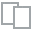
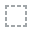
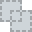
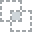
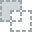
...
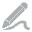
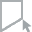
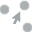
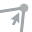
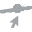

In [131]:
plot(df)

In [132]:
# For the year 2014
df2014 = df[df['year'].dt.year == 2014]
df2014

,country,year,log_lp,log_ky,log_h,log_tfp,region,hi1990
id,,,,,,,,
1,Albania,2014-01-01,10.490668,1.288642,1.287595,6.138250,Europe,no
2,Algeria,2014-01-01,10.777947,1.110468,1.048142,7.330354,Africa,no
3,Argentina,2014-01-01,10.758764,0.860546,1.252455,7.509842,Americas,no
4,Armenia,2014-01-01,10.142462,0.389373,1.345050,6.269046,Asia,no
5,Australia,2014-01-01,11.405924,1.282674,1.407372,7.602583,Oceania,yes
...,...,...,...,...,...,...,...,...
104,Uruguay,2014-01-01,10.543014,1.386616,1.136070,6.402820,Americas,no
105,Venezuela,2014-01-01,10.676869,1.456214,1.206553,7.148298,Americas,no
106,Vietnam,2014-01-01,9.187414,1.144392,1.088757,6.767172,Asia,no


  0%|          | 0/327 [00:00<?, ?it/s]


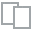
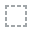
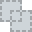
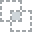
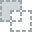
...
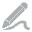
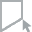
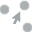
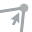
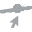

In [133]:
plot(df2014)

## Time series plots

Indicate that the `year` column is a a `date` column

In [144]:
df100 = pd.read_csv('https://raw.githubusercontent.com/quarcs-lab/mendez2020-convergence-clubs-code-data/master/assets/dat.csv', parse_dates =['year'], index_col = 0)
plot(df100, 'log_lp', 'year', 'region', agg='mean')

ValueError: x, y, and z must be one each of type datetime, numerical, and categorical

  0%|          | 0/7 [00:00<?, ?it/s]


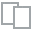
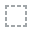
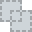
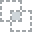
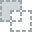
...
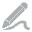
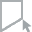
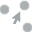
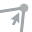
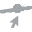

In [150]:
plot(df, 'year', 'log_lp')

## Univariate cross-sectional analysis

  0%|          | 0/107 [00:00<?, ?it/s]


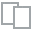
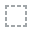
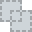
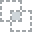
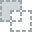
...
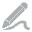
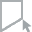
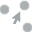
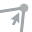
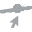

In [135]:
plot(df2014, 'log_lp')

/Users/carlos/anaconda3/envs/tryPython37/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)


  0%|          | 0/74 [00:00<?, ?it/s]

/Users/carlos/anaconda3/envs/tryPython37/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)



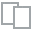
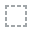
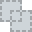
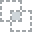
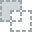
...
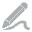
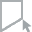
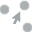
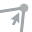
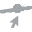

In [152]:
plot(df2014, 'region')

  0%|          | 0/30 [00:00<?, ?it/s]


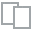
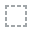
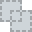
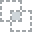
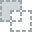
...
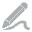
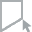
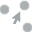
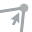
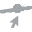

In [142]:
plot(df2014, 'region', 'log_lp')


  0%|          | 0/30 [00:00<?, ?it/s]


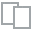
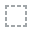
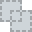
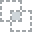
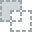
...
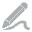
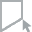
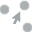
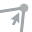
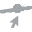

In [145]:
plot(df2014, 'hi1990', 'log_lp')

/Users/carlos/anaconda3/envs/tryPython37/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)


  0%|          | 0/74 [00:00<?, ?it/s]

/Users/carlos/anaconda3/envs/tryPython37/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)



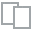
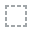
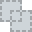
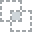
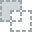
...
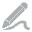
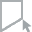
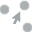
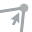
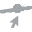

In [153]:
plot(df2014, 'hi1990')


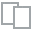
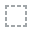
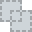
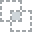
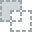
...
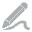
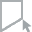
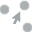
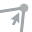
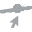

In [154]:
plot(df2014, 'region', 'hi1990')

## Correlations


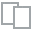
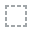
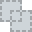
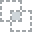
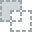
...
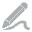
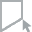
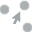
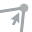
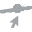

In [147]:
plot_correlation(df2014)

  0%|          | 0/88 [00:00<?, ?it/s]


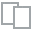
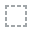
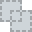
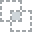
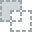
...
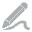
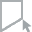
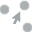
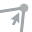
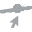

In [146]:
plot_correlation(df2014,'log_lp')

  0%|          | 0/12 [00:00<?, ?it/s]


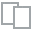
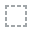
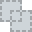
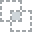
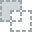
...
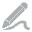
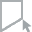
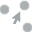
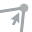
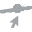

In [148]:
plot_correlation(df2014, 'log_h', 'log_lp')

  0%|          | 0/10 [00:00<?, ?it/s]


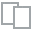
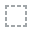
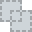
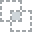
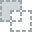
...
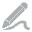
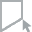
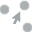
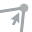
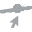

In [149]:
plot(df2014, 'log_h', 'log_lp')

## Missing data

  0%|          | 0/129 [00:00<?, ?it/s]


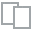
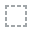
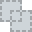
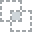
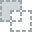
...
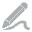
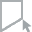
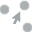
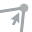
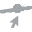

In [151]:
plot_missing(df2014)

## Create report

In [156]:
report = create_report(df2014, title='My Report')

/Users/carlos/anaconda3/envs/tryPython37/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)
/Users/carlos/anaconda3/envs/tryPython37/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)
/Users/carlos/anaconda3/envs/tryPython37/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)


  0%|          | 0/834 [00:00<?, ?it/s]

/Users/carlos/anaconda3/envs/tryPython37/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)
/Users/carlos/anaconda3/envs/tryPython37/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)


My Report
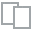
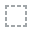
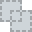
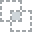
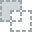
...
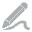
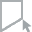
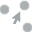
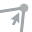
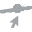

In [157]:
report

In [158]:
#open the report in browser:
report.show_browser()

In [159]:
#save the report to local:
report.save(filename='report_01', to='~/Desktop')

Report has been saved to /Users/carlos/Desktop/report_01.html!
